# Self-Driving Car Engineer Nanodegree


## Project: **Finding Lane Lines on the Road** 


## Import Packages

In [7]:
#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import imageio
import cv2
from statistics import mean 
%matplotlib inline

## Read in an Image

## Helper Functions

Below are some helper functions to help get you started. They should look familiar from the lesson!

In [60]:
import math
from IPython.core.debugger import set_trace

def outliers_indexes(values: []):
        #This is a copy
        dataset  = np.array(values)
        
        q1, q3= np.percentile(dataset,[25,75])
        iqr = q3 - q1
        lower_bound = q1 -(1.5 * iqr) 
        upper_bound = q3 +(1.5 * iqr) 
        
        #This is not a copy but a mittoring
        mirrored_dataset  = np.asarray(values)
        
        min_outliers = np.where(mirrored_dataset < lower_bound)
        max_outliers = np.where(mirrored_dataset > upper_bound)
        outliers = list(min_outliers[0])
        outliers.extend(max_outliers[0])
        return outliers
        
def del_outliers(line_m: [], line_b: []):
    outlier_indexes = outliers_indexes(line_m)
    outlier_indexes.extend(outliers_indexes(line_b))
    outlier_indexes = np.unique(outlier_indexes)[::-1]
    for index in outlier_indexes:       
        del line_m[index]
        del line_b[index]

class MeanBM:
    def __init__(self, deep: int):
        self.deep = deep
        self.m_left_array = []
        self.b_left_array = []
        self.m_right_array = []
        self.b_right_array = []
        self.max_y_array = []
        self.min_y_array = []
        
    def add_m_b(self, m_left: int, b_left: int, m_right: int, b_right: int, min_y: int, max_y: int):
        self.m_left_array.append(m_left)        
        self.b_left_array.append(b_left)
        self.m_right_array.append(m_right)        
        self.b_right_array.append(b_right)
        self.min_y_array.append(min_y)
        self.max_y_array.append(max_y)
        
        del_outliers(self.m_left_array, self.b_left_array)
        del_outliers(self.m_right_array, self.b_right_array)

        while len(self.m_left_array) > self.deep:
            del self.m_left_array[0]
            del self.b_left_array[0]
            del self.m_right_array[0]
            del self.b_right_array[0]
            del self.min_y_array[0]
            del self.max_y_array[0]
        
    def get_m_b_means(self):
        if len(self.m_left_array) > 0:
            return mean(self.m_left_array), mean(self.b_left_array), mean(self.m_right_array), mean(self.b_right_array), mean(self.min_y_array), mean(self.max_y_array)

def grayscale(img):
    """Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    (assuming your grayscaled image is called 'gray')
    you should call plt.imshow(gray, cmap='gray')"""
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Or use BGR2GRAY if you read an image with cv2.imread()
    # return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    `vertices` should be a numpy array of integer points.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

        
def draw_line(m_mean, b_mean, min_y, max_y, img, color1, thickness):

    x_min_y = int((min_y - b_mean) /  m_mean)
    x_max_y = int((max_y - b_mean) /  m_mean)
    cv2.line(img, (x_min_y,  min_y), (x_max_y, max_y),  color1, thickness)        

def draw_lines(img, lines, mean_b_m: MeanBM, debug = True, remove_outliers = False, color1=[255, 0, 0], color2=[0, 0, 255], color3=[0, 255, 0], thickness=10):

    if lines is not None and len(lines) > 0:
        left_line_m = []
        left_line_b = []
        right_line_m = []
        right_line_b = []
        min_y = lines[0][0][1]
        max_y = min_y
        
        for line in lines:
            for x1,y1,x2,y2 in line:
                if x2 != x1:
    
                    m = (y1-y2)/(x1-x2)
                    b = y2 - x2 * m
                    min_y = min(min_y, y1, y2)
                    max_y = max(max_y, y1, y2)
                    if m > 0:
                        if debug: cv2.line(img, (x1, y1), (x2, y2), color2, thickness * 2)
                        right_line_m.append(m)
                        right_line_b.append(b)
                    elif m < 0:
                        if debug: cv2.line(img, (x1, y1), (x2, y2), color3, thickness * 2)
                        left_line_m.append(m)
                        left_line_b.append(b)
        
        # List are used to append elements as they are faster when appending elements
        # according to https://stackoverflow.com/questions/6950456/how-to-create-a-dynamic-array
        # However to compute outliers iqr methods is easily implemented with numpy
        if len(right_line_m) > 0 and len(right_line_b) > 0 and len(left_line_m) > 0 and len(left_line_b) > 0:
            if remove_outliers:
                if debug: print("Before removing outliers mean of (left_m, left_b, right_m, right_b)=", mean(left_line_m), mean(left_line_b), mean(right_line_m), mean(right_line_b))
                del_outliers(left_line_m, left_line_b)
                del_outliers(right_line_m, right_line_b)
                if debug: print("After removing outliers mean of (left_m, left_b, right_m, right_b)=", mean(left_line_m), mean(left_line_b), mean(right_line_m), mean(right_line_b))
    
            mean_b_m.add_m_b(mean(left_line_m),  mean(left_line_b), mean(right_line_m), mean(right_line_b), min_y, max_y)
            left_m_mean , left_b_mean , right_m_mean, right_b_mean, mean_min_y, mean_max_y = mean_b_m.get_m_b_means()
            
            draw_line(left_m_mean,  left_b_mean,  mean_min_y, mean_max_y, img, color1, thickness)
            draw_line(right_m_mean, right_b_mean, mean_min_y, mean_max_y, img, color1, thickness)

    
def hough_lines(img, rho, theta, threshold, min_line_len, max_line_gap, mean_b_m: MeanBM, debug = True, remove_outliers = False):
    """
    `img` should be the output of a Canny transform.
        
    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    draw_lines(line_img, lines, mean_b_m, debug, remove_outliers)
    return line_img

# Python 3 has support for cool math symbols.

def weighted_img(img, initial_img, α=0.8, β=1., γ=0.):
    """
    `img` is the output of the hough_lines(), An image with lines drawn on it.
    Should be a blank image (all black) with lines drawn on it.
    
    `initial_img` should be the image before any processing.
    
    The result image is computed as follows:
    
    initial_img * α + img * β + γ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, γ)

def show_reduced_area(image, vertices, thickness):
    fromPoint=None
    for point in vertices[0]:
        if fromPoint is not None:
            cv2.line(image, fromPoint, (point[0], point[1]), (0, 0, 255), thickness)        
        fromPoint = (point[0], point[1])



## Build a Lane Finding Pipeline



Build the pipeline and run your solution on all test_images. Make copies into the `test_images_output` directory, and you can use the images in your writeup report.

Try tuning the various parameters, especially the low and high Canny thresholds as well as the Hough lines parameters.

In [61]:
def add_road_lines(image, mean_b_m: MeanBM, debug = False, remove_outliers = False):
    gray = grayscale(image)
    
    blur_gray = gaussian_blur(gray, 3)
    
    edges = canny(blur_gray, 130, 250)
    
    imshape = image.shape
    x_offset = imshape[1] / 20
    vertices = np.array([[(0,imshape[0]),
                          (imshape[1] / 2 - x_offset,  3 * imshape[0] / 5), 
                          (imshape[1] / 2 + x_offset,  3 * imshape[0] / 5), 
                          (imshape[1],imshape[0])]], dtype=np.int32)
    
    masked_edges = region_of_interest(edges, vertices)
    
    rho = 1             # distance resolution in pixels of the Hough grid
    theta = np.pi/180   # angular resolution in radians of the Hough grid
    threshold = 1       # minimum number of votes (intersections in Hough grid cell)
    min_line_len = 15   # minimum number of pixels making up a line
    max_line_gap = 1    # maximum gap in pixels between connectable line segments
    
    lines = hough_lines(masked_edges, rho, theta, threshold, min_line_len, max_line_gap, mean_b_m, debug, remove_outliers)
    lines_edges = weighted_img(lines, image, 0.8, 1, 0)
    
    if debug: show_reduced_area(lines_edges, vertices, 10)
    
    plt.figure()
    plt.imshow(lines_edges)
    
    return lines_edges # [ elt for elt in lines_edges ]




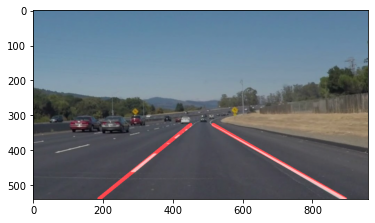

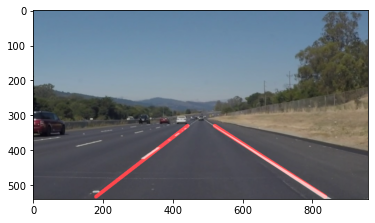

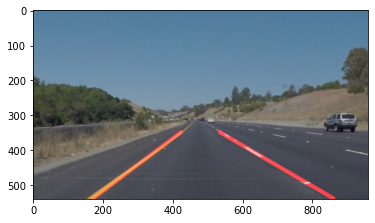

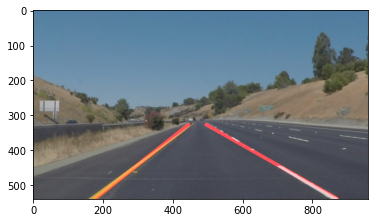

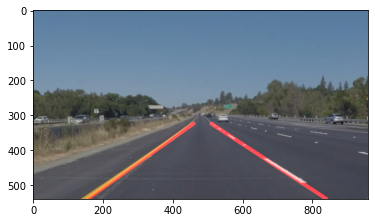

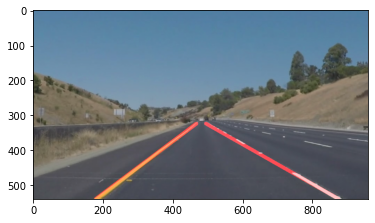

In [44]:
import os

for image_name in os.listdir("test_images/"):
    mean_b_m = MeanBM(5)
    image = mpimg.imread('test_images/' + image_name)
    line_edges = add_road_lines(image, mean_b_m, False)
    image_out='test_images_output/'+image_name
    imageio.imwrite(image_out, line_edges)



## Test on Videos



In [17]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
    

In [62]:
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)
    result = add_road_lines(image, mean_b_m, False, True) 
    return result

Let's try the one with the solid white lane on the right first ...

Moviepy - Building video test_videos_output/solidWhiteRight.mp4.
Moviepy - Writing video test_videos_output/solidWhiteRight.mp4



Moviepy - Done !
Moviepy - video ready test_videos_output/solidWhiteRight.mp4
Wall time: 15.2 s


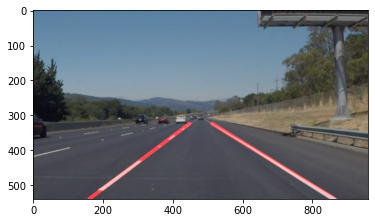

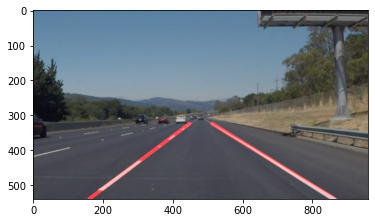

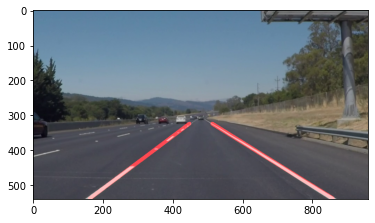

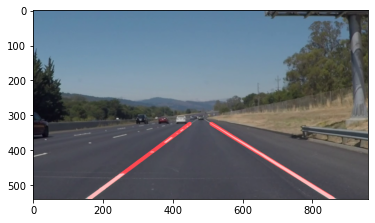

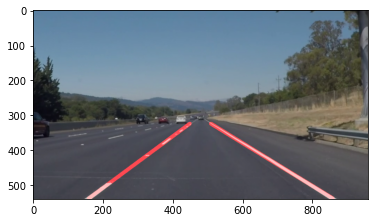

...

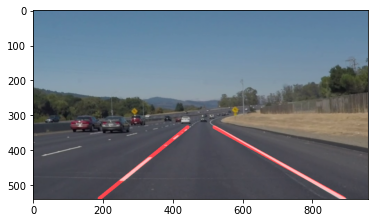

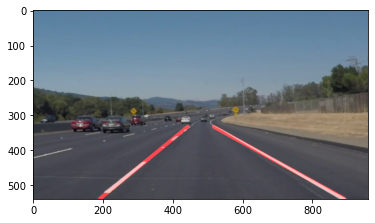

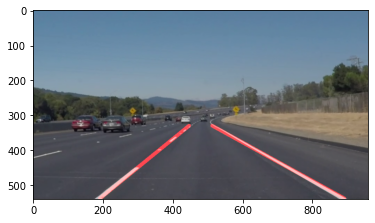

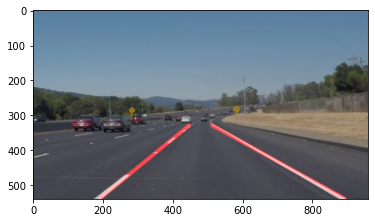

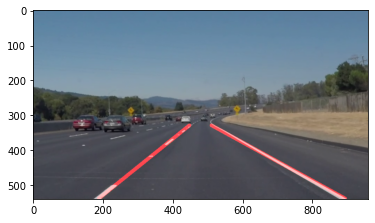

In [19]:
white_output = 'test_videos_output/solidWhiteRight.mp4'
mean_b_m = MeanBM(5)

## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

Play the video inline, or if you prefer find the video in your filesystem (should be in the same directory) and play it in your video player of choice.

## Improve the draw_lines() function



Now for the one with the solid yellow lane on the left. This one's more tricky!

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(yellow_output))

## Writeup and Submission

If you're satisfied with your video outputs, it's time to make the report writeup in a pdf or markdown file. Once you have this Ipython notebook ready along with the writeup, it's time to submit for review! Here is a [link](https://github.com/udacity/CarND-LaneLines-P1/blob/master/writeup_template.md) to the writeup template file.


## Optional Challenge

Try your lane finding pipeline on the video below.  Does it still work?  Can you figure out a way to make it more robust?  If you're up for the challenge, modify your pipeline so it works with this video and submit it along with the rest of your project!

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_output))